# The FeS<sub>2</sub> example

This notebook shows how the X-Ray Larch library (Larch) can be used to get results equivalent to those obtainde using Demeter (Artemis and Athena). It also illustrates how the notebook structure can be used as an alternative to publish data while including the provenance on how the processing and analysis were performed.

The [FeS<sub>2</sub> example](https://github.com/bruceravel/XAS-Education/tree/master/Examples/FeS2) is well documented example used to introduce the main features of Athena and Artemis. The example covers the basic processing and analysis of XAS data going from raw XAS data to EXAFS fit. 

The sources consulted to complete the example it is discused include the [Artemis Users’ GuideFeS2](http://bruceravel.github.io/demeter/artug/examples/fes2.html), the [2011 XAS workshop at Diamond](https://vimeo.com/340207346) and a discussion of the [fit and its model](https://speakerdeck.com/bruceravel/discussion-of-the-fes2-exafs-analysis-example). Addtionally, the [Larch user guide](https://xraypy.github.io/xraylarch/) was consulted to identify the functions required for each step.

There are two setup steps: Importing libraries and functions and defining inputs. After these, each step of the FeS<sub>2</sub> example are solved one by one. 

### Setup 1 Imports, libraries, and functions:
Get libraries and define functions for processing and inspection of results

In [1]:
# Larch libraries are imported for processing data 

############################################
#        functions for step 1              #
############################################

# to read from text files
from larch.io import read_ascii

############################################
#        functions for step 2              #
############################################
# Pre-edge subtraction and normalization
from larch.xafs import pre_edge

# Background subtraction
from larch.xafs import autobk

# Forward XAFS Fourier transform
from larch.xafs import xftf

# import plot labels to avoid having to type the markup
from larch.wxlib import plotlabels as plab

####################################################
# custom libraries to hide functions calling Larch #
####################################################

# Library with the functions that handle athena files
import lib.manage_athena as athenamgr  

# Library with the functions that execute 
# Atoms and FEFF to generate scattering paths
import lib.atoms_feff as feff_runner     

# Set parameters          
# library containign functions tho manage fit, at read, write 
# GDS parameters, and scattering paths. 
import lib.manage_fit as fit_manager  

from larch import Interpreter

############################################
#        functions for steps 3 & 4         #
############################################
# import the larch.io libraries for managing athena files
from larch.io import create_athena, read_athena, extract_athenagroup

############################################
#        Functions for step 10
############################################
# for working with parameters
from larch import ParameterGroup

# working with paths
from larch.xafs import path2chi, feffpath


from larch.utils import group2dict, dict2group

from pathlib import Path

import matplotlib.pyplot as plt
%matplotlib inline

from numpy import log


############################################
#          Display functions               #
############################################
# the following show the contents of each group
def show_data(groups_list):
    for fe_xas in groups_list:
        print("path:\t\t", fe_xas.path)
        print("filename:\t", fe_xas.filename)
        print(fe_xas.header)
        print(fe_xas.data)
        print(fe_xas.attrs)
        print(fe_xas.array_labels)
        print('energy:', fe_xas.energy)
        print('i0:',fe_xas.i0)
        print('xmu:',fe_xas.mu)    

# plot mu on energy for each group on the list
def plot_mu(groups_list, p_width=6.4, p_height=4.8, title="", pre_edge = False, post_edge = False):
    plt.rcParams['figure.figsize'] = [p_width, p_height]
    for group_xas in groups_list:
        if pre_edge:
            plt.plot(group_xas.energy, group_xas.pre_edge, 'g', label='pre-edge') # plot pre-edge in green
        if post_edge:
            plt.plot(group_xas.energy, group_xas.post_edge, 'r', label='post-edge')# plot post-edge in green
        plt.plot(group_xas.energy, group_xas.mu, 'b', label=group_xas.filename) # plot mu in blue
        plt.grid(color='r', linestyle=':', linewidth=1) #show and format grid
        plt.xlabel('Energy (eV)') # label y graph
        plt.ylabel('x$\mu$(E)') # label y axis
        if title != "":
            plt.title(title)
        if pre_edge and post_edge:
            plt.title("pre-edge and post_edge fitting $\mu$ in Energy")
        else:
            plt.title("$\mu$ in Energy" )
        plt.legend() # show legend
        plt.show()

def plot_normalised(groups_list, p_width=6.4, p_height=4.8):
    plt.rcParams['figure.figsize'] = [p_width, p_height]
    for group_xas in groups_list:
        plt.plot(group_xas.energy, group_xas.flat, label=group_xas.filename) # plot flattened and normalised energy
        plt.grid(color='r', linestyle=':', linewidth=1) #show and format grid
        plt.xlabel('Energy (eV)') # label y graph
        plt.ylabel(r'normalised x$\mu$(E)') # label y axis
        plt.legend() # show legend
        plt.show()
        
def plot_mu_and_norm(groups_list, p_width=12.8, p_height=4.8):
    plt.rcParams['figure.figsize'] = [p_width, p_height]
    for group_xas in groups_list:
        # first plot shows absorption with pre edge and post edge lines
        plt.subplot(1, 2, 1)
        plt.plot(group_xas.energy, group_xas.pre_edge, 'g', label='pre-edge') # plot pre-edge in green
        plt.plot(group_xas.energy, group_xas.post_edge, 'r', label='post-edge')# plot post-edge in green
        plt.plot(group_xas.energy, group_xas.mu, 'b', label=group_xas.filename) # plot mu in blue
        plt.grid(color='r', linestyle=':', linewidth=1) #show and format grid
        plt.xlabel('Energy (eV)') # label y graph
        plt.ylabel('x$\mu$(E)') # label y axis
        plt.title("pre-edge and post_edge fitting to $\mu$")
        plt.legend() # show legend
        # second plot shows normalised absorption
        plt.subplot(1, 2, 2)
        plt.plot(group_xas.energy, group_xas.flat, label=group_xas.filename) # plot flattened and normalised energy
        plt.grid(color='r', linestyle=':', linewidth=1) #show and format grid
        plt.xlabel('Energy (eV)') # label y graph
        plt.ylabel(r'normalised x$\mu$(E)') # label y axis
        plt.legend() # show legend
        
# https://vimeo.com/340207346 40:00
# plot magnitude in r-space
def plot_in_r(groups_list, p_width=6.4, p_height=4.8):
    plt.rcParams['figure.figsize'] = [p_width, p_height]
    for group_xas in groups_list:
        plt.plot(group_xas.r, group_xas.chir_mag, label=group_xas.filename)
        plt.xlabel(plab.r)
        plt.ylabel(plab.chirmag.format(3))
        plt.grid(linestyle=':', linewidth=1) #show and format grid
        plt.xlim(0,6)
        plt.legend()
    plt.show()
    
def plot_in_k(groups_list, p_width=6.4, p_height=4.8):
    plt.rcParams['figure.figsize'] = [p_width, p_height]
    for group_xas in groups_list:
        plt.plot(group_xas.k, group_xas.chi*group_xas.k**2, label=group_xas.filename)
        plt.xlabel(plab.r)
        plt.ylabel(plab.chir.format(2))
        plt.title(group_xas.filename+" in k space")
        plt.grid(linestyle=':', linewidth=1) #show and format grid
        plt.xlim(0,14.5)
        plt.legend()
    plt.show()

No conda env active, defaulting to base


### Setup 2: Define the inputs for the exercise

The two data files provided for the exampe  saved in a folder called data. This folder wil also be used for saving intermediate results. 

In addition to these three files, a variable setting the names of the colums is provided to facilitate the identification of the data after the import. This is only required because the fes2_rt01_mar02.xmu file names the mu column as xmu.

---
**Reuse**

The input variables for this exercise can be changed to reuse the code.

---

In [2]:
# reproduction needs to record these variables as "external inputs" to the code
data_location = "./data"

# XAS input file 
fes2_file = 'fes2_rt01_mar02.xmu'
data_labels = "energy mu i0"

# crystal file can be used in fitting
fes2_structure = "FeS2.inp"


### 1. Import data

Import the data file 'fes2_rt01_mar02.xmu'.

---
**Answer**

Use the larch "read ascii". The function the name of the file and a string with the labels for the data columns.

As the provided file contains mu, there is no need to calculate it, just need to label the data accordingly.

---

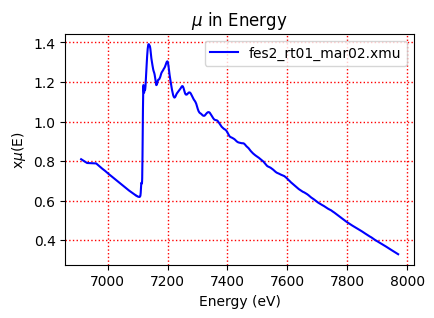

In [3]:
# fe_xas is not an input 
# it is an intermediate output from the read operation,
# its evolution is preserved into the athena project and the plots
fe_xas=None

# read ascii files
# labels tell the reader how to name the resulting columns
# eneregy and mu are the most important labels
input_file = Path(data_location,fes2_file)
fe_xas = read_ascii(input_file, labels = data_labels)


# plot_mu(fe_xas) was defined in the first cell of this notebook

plot_mu([fe_xas],4.5,3,"")

### 2. Background removal and Fourier transform.
Find a set of parameters that gives a good background removal and Fourier transform. Note that the first few data points in the pre-edge are odd – be sure to select pre-edge parameters that avoid that bit of data.

---
**Answer**
- normalise as it is to see the problem
- set the pre-edge to avoid first reading causing problems
---


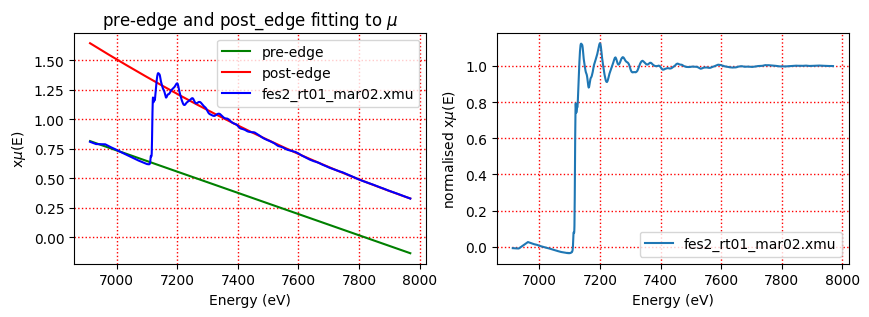

In [4]:
# calculate pre-edge and post edge and add them to group
# we want to avoid the data below E0 - 117.00
pre_edge(fe_xas, group=fe_xas)

plot_mu_and_norm([fe_xas],10,3)

The initial values of the data skew the pre-edge fitting and affect the normalisation. Setting the pre-edge values to exclude those initial values corrects this issue.

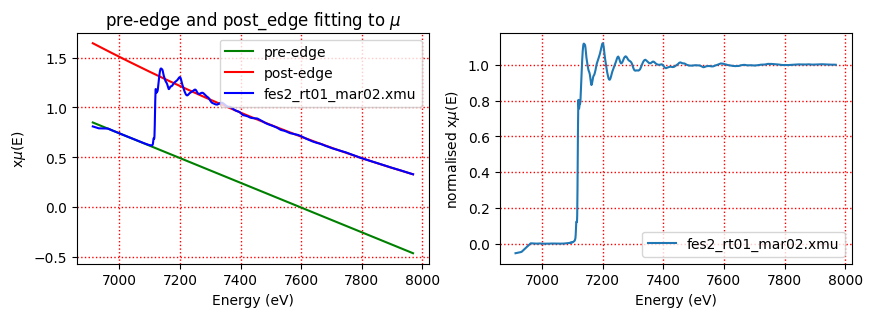

In [54]:
# normalise setting pre_edge to [-117,-30] 
# try other values of pre1= -190, -180, -150, -130, -90,-80
pre_edge(fe_xas, group=fe_xas, pre1=-117, pre2=-30)
    
plot_mu_and_norm([fe_xas],10,3)    
#plot_mu_pre_post(fe_xas)
#plot_normalised(fe_xas)

Background removal is done with autobk

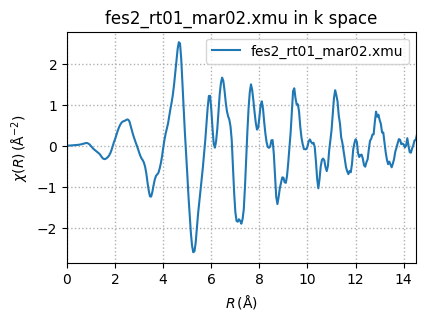

In [6]:
autobk(fe_xas, rbkg=1.0)
plot_in_k([fe_xas],4.5,3)

Fourier transform isdone with xftf. 

The defaults give the same result as athena so no parameters were changed.

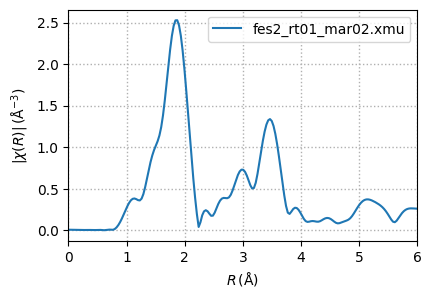

In [7]:
xftf(fe_xas)#, kweight=0.5, kmin=2.0, kmax=15, dk=4, kwindow='Hanning')
# Larch defaults seem to work better than trying to force athena default values
plot_in_r([fe_xas],4.5,3)

### 3. Save Athena Project

In [8]:
# save as an athena project
project_name = Path(data_location,'fes2.prj')
fe_project = create_athena(project_name)
fe_project.add_group(fe_xas)
fe_project.save()
vars(fe_project)

{'_larch': None,
 'groups': OrderedDict([('fes2_rt01_mar02_xmu', <Group 0x102eb0c3730>),
              ('petal', <Group ascii_file data\fes2_rt01_mar02.xmu>)]),
 'header': '# Athena project file -- Demeter version 0.9.24\n# This file created at 2024-06-12T19:28:28\n# Using Larch version 0.9.71, Python 3.9.2rc1 on Windows-10-10.0.22621-SP0\n',
 'journal': '',
 'filename': WindowsPath('data/fes2.prj'),
 'group_names': ['fes2_rt01_mar02_xmu']}

### 4. Import data from Athena file.
Start Artemis and import the athena file

---
**Answer**

In this case we keep using Larch, as it can also handle EXAFS fitting using feff.

To keep the same defaults as the Artemis, a fit vars variable is created.  Also a Larch session is also created to hanlde the finding of paths, fitting and reporting.

---

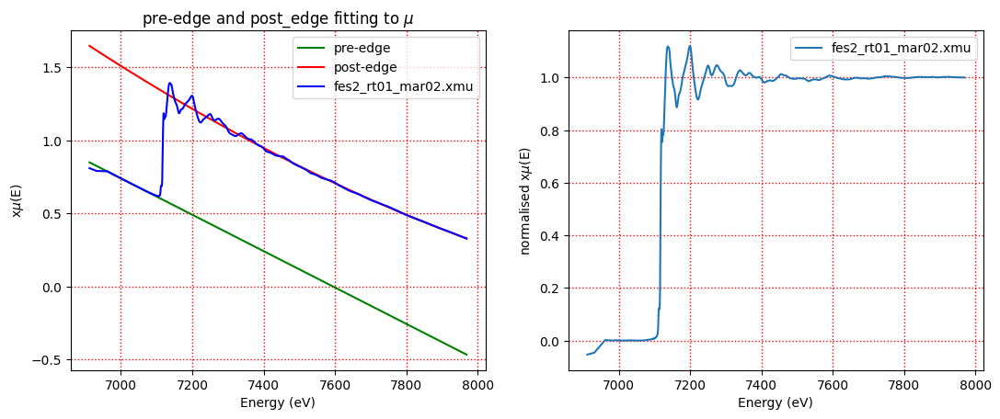

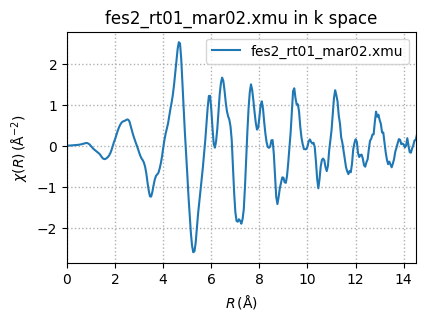

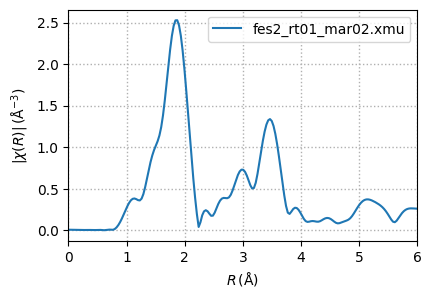

In [9]:

athena_file = project_name
athena_prj = read_athena(athena_file)

athena_groups = athenamgr.get_groups(athena_prj)

# recalculate norm, background removal and fourier transform 
# with defaults
data_group = athenamgr.calc_with_defaults(athena_groups[0])

# start a larch session to manage fit and paths
session = Interpreter()

# variables for fit
fit_vars = {}
fit_vars['fitspace']='r'
fit_vars['kmin']=3 
fit_vars['kmax']=14
fit_vars['kw']=2 
fit_vars['dk']=1
fit_vars['window']='hanning'
fit_vars['rmin']=1.4
fit_vars['rmax']=3.0


# show that the project saves the processing (pre-edge settings, normalisation, etc)
plot_mu_and_norm(athena_groups)
plt.show()
plot_in_k(athena_groups,4.5,3)
plot_in_r(athena_groups,4.5,3)

### 6-7 Import FeS<sub>2</sub> adn run FEFF
Import the crystallographic data contained in the file FeS2.inp. Run Atoms. Note that you can set the cluster size independently of Rmax, the length of the longest path to be calculated.

Verify that the Feff input data is reasonable, then run Feff.

---

**Answer**

A custom script (atoms_feff.py) was created to handle the running of feff and atoms. The script uses pymatgem to read cif data and convert ot inp. In this case that is not required as the input data (FeS2.inp) are already in the correct format.

The function reads the inp file, runs feff and creates a directory containing all the path files and feff sumaries.

The result is a list of feff directories, one for each crystal/inp file provided

In [10]:
# run feff and get a list of feff dirs
crystals = [Path(data_location,fes2_structure)]
feff_dirs = feff_runner.run_feff(crystals)

Processing: data\FeS2.inp
check if need to build: FeS2_feff
copying: FeS2.inp  to  FeS2_feff\FeS2_feff.inp
 : ======== running Feff module C:\Users\scman1\AppData\Local\Programs\Python\Python39\lib\site-packages\larch\bin\win64\feff6l.exe ========
 : Feff 6L.02
 : name:     Iron sulfide (pyrite)
 : formula:  FeS_2
 : refer1:   Elliot (1960) J.Chem. Phys. 33(3), 903.
 : Calculating potentials and phases...
 : free atom potential and density for atom type    0
 : free atom potential and density for atom type    1
 : free atom potential and density for atom type    2
 : overlapped potential and density for unique potential    0
 : overlapped potential and density for unique potential    1
 : overlapped potential and density for unique potential    2
 : muffin tin radii and interstitial parameters
 : phase shifts for unique potential    0
 : phase shifts for unique potential    1
 : phase shifts for unique potential    2
 : Preparing plane wave scattering amplitudes...
 : nncrit in prcrit 

### 8. Select Paths
Select the first 11 paths in the path interpretation by setting the value of the select columt to 1 (0 means not selected) then run the code cell a bellow the table to update the "selected paths"  varaible and save the values to the csv file.

---
**Answer**

Larch does not handle Artemis projects. For this GSD parameters and scattering paths are saved to csv files (alternatively we could save a larch project which can store all these data plus the intermediate results).

To select the paths just set the value of the select column to 1

---

In [11]:
sp_file = "fes2_sp_08.csv"
sp_list_csv = Path(data_location, sp_file)

# a list is declared to hold the selected paths
selected_paths =[]
if (sp_list_csv.exists()):
    # read saved parameters from input gds file
    selected_paths = fit_manager.read_selected_paths_list(sp_list_csv, session)

path_sheet = fit_manager.show_feff_paths(crystals, selected_paths)
display(path_sheet)

Sheet(cells=(Cell(column_end=7, column_start=0, row_end=48, row_start=0, squeeze_column=False, squeeze_row=Fal…

In [12]:
# read the paths from the path sheet and put them in a new path list and a spreadsheet for showing later
selected_paths = fit_manager.update_paths_list(path_sheet,selected_paths, session)
sp_sheet = fit_manager.show_selected_paths(path_sheet, selected_paths)

# save the selected paths to the csv file
sel_paths_csv = Path(data_location, sp_file)
fit_manager.save_selected_paths_list(sp_sheet, sel_paths_csv)

### 9. Test paths vs data

Path sheet has a reference to the eleven paths selected (their name and file location) a loop can be used to plot each path agaist the spectra data. Looking at the peaks on each path we can see which ones may look like contributors to the experimental spectra.
- Put the data and the first path in the plotting list. See how it contributes spectral weight in the region of the first peak.
- Clear the plotting list and put the data and the next three single scattering paths in the plotting list. Where do those paths contribute spectral weight?
- Plot the various multiple scattering paths along with the data. Do any of these MS paths seem like they might be important contributions to the fit?

---
**Answer**

A for loop is used to read the paths one by one, then chi and fourier transform are created from the path data.
This allows plotting in R and compare the peaks of the path to the peaks on the spectra

---

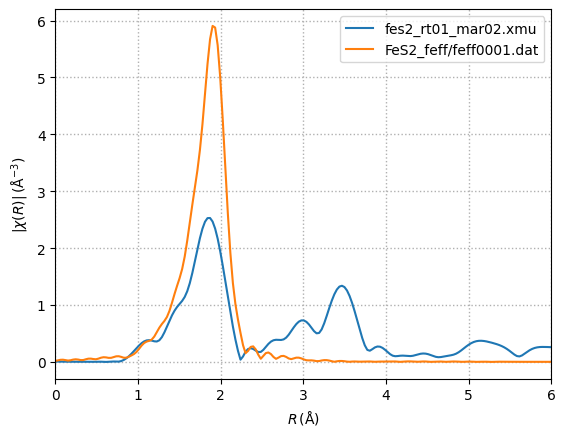

True


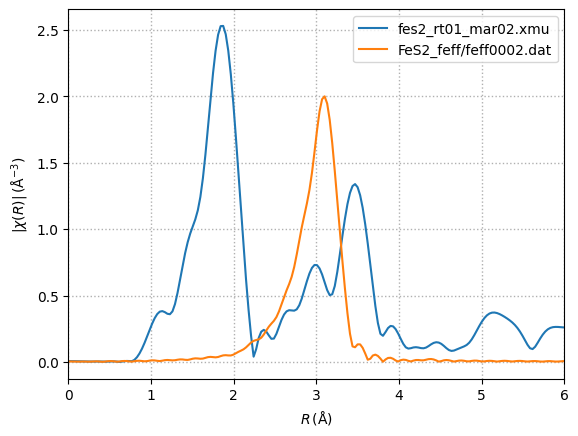

True


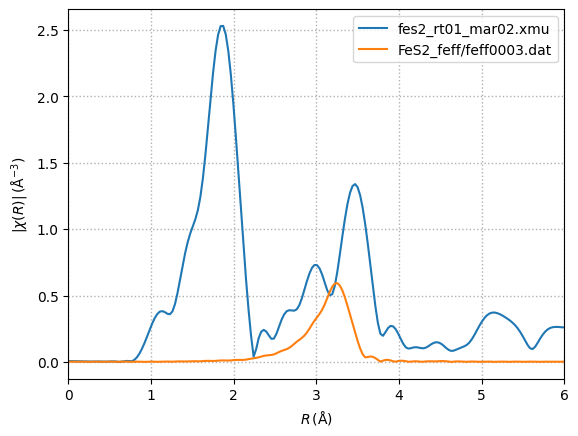

True


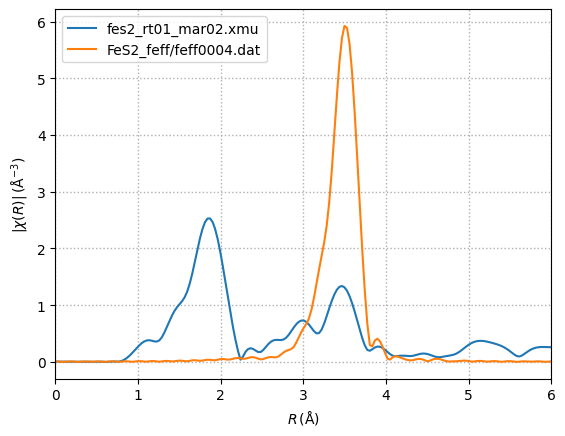

True


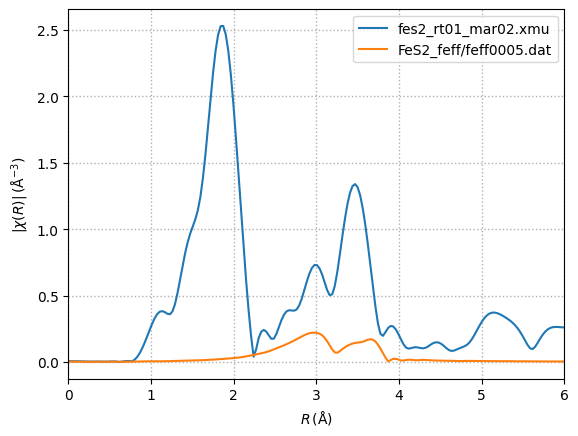

True


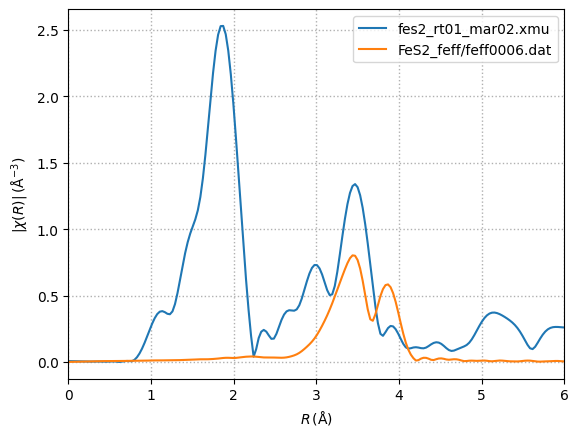

True


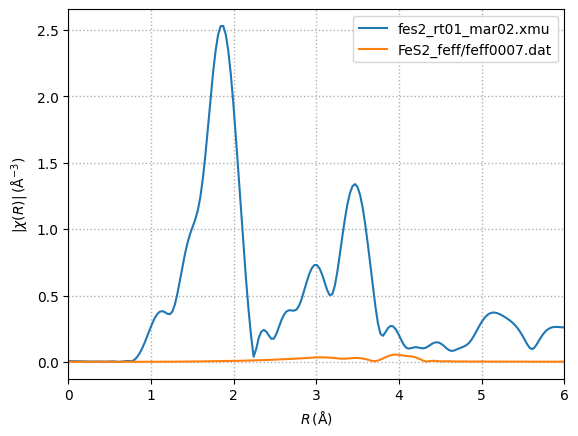

True


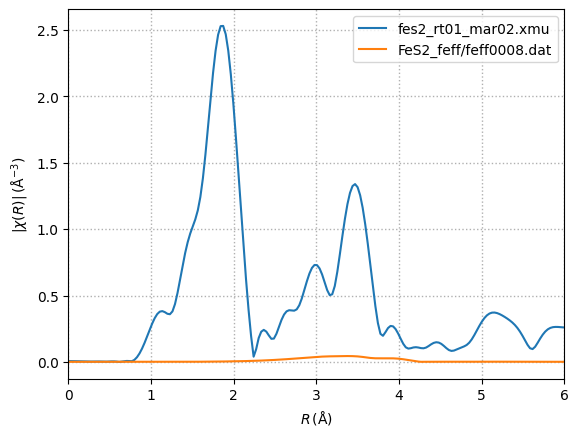

True


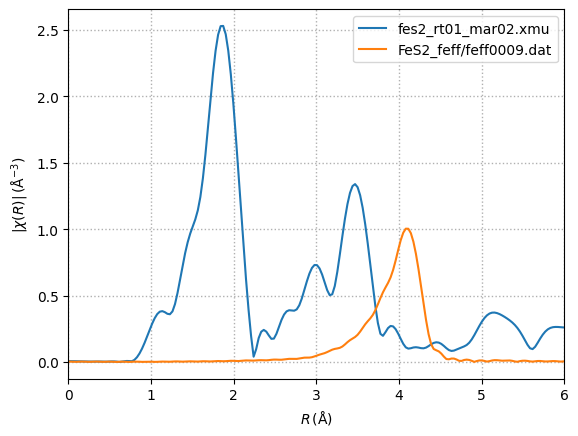

True


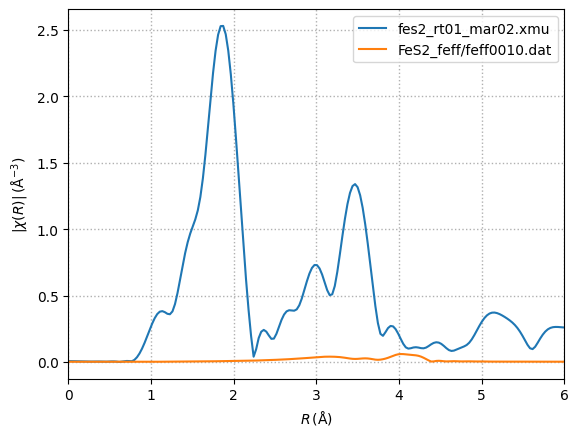

True


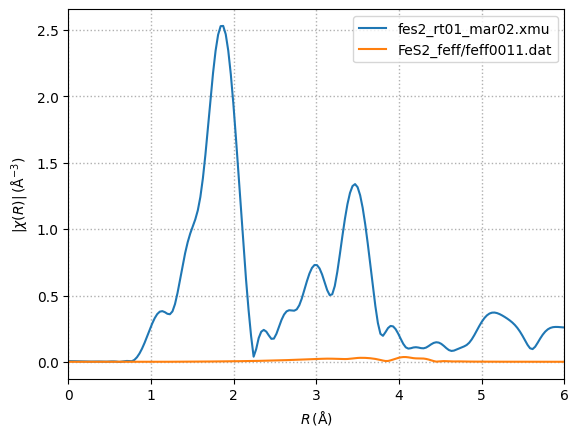

True


In [13]:
#get the path list from the table 
selected_paths = fit_manager.update_paths_list(path_sheet, selected_paths, session)

# loop the path list to compare spectra to path data
for a_path in selected_paths:
    a_feff_path= feffpath(a_path.filename)
    # get chi from the path data
    path2chi(a_feff_path)
    # get fft from the path data
    xftf(a_feff_path)
    # plot spectra and path in R
    plot_in_r([athena_groups[0],a_feff_path])
    print (a_path.use)


### 10. Define parameters
Click the GDS button to open the parameters window. Create 4 guess parameters called “amp”, “enot”, “delr”, and “ss”. The initial guess for amp should be 1. ss should be 0.003. The other two can be 0.

---
**Answer**

A spreadsheet is used to allow the definition of parameters. These were previously saved to a csv file called "fes2_gds_10.csv"

---

In [14]:
gds_file = "fes2_gds_10.csv"
fit_gds_variables_csv = Path(data_location, gds_file)

gds = ParameterGroup()
if (fit_gds_variables_csv.exists()):
    # read saved parameters from input gds file
    gds = fit_manager.read_gds(fit_gds_variables_csv, session)

# show gsd group parameters in a spreadsheet
this_sheet = fit_manager.show_gds(gds)

Sheet(cells=(Cell(column_start=0, row_end=14, row_start=0, squeeze_column=False, squeeze_row=False, value=[['i…

In [15]:
#read the gds data and save it to the csv file
gds = fit_manager.spreadsheet_to_gds(this_sheet, session)
# save gsd group parameters in a csv file
fit_gds_variables_csv = Path(data_location,gds_file)
fit_manager.save_gds(gds, fit_gds_variables_csv)

### 11. Assing parameters to 1st path 
Deploy these four parameters as the path parameter values for the first shell.

In [16]:
sp_file = "fes2_sp_11.csv"
sp_list_csv = Path(data_location, sp_file)

# a list is declared to hold the selected paths
selected_paths =[]
if (sp_list_csv.exists()):
    # read saved parameters from input gds file
    selected_paths = fit_manager.read_selected_paths_list(sp_list_csv, session)


# show the selected paths and allow assigning GDS variables
# in this case only sigma2 varies
sp_sheet = fit_manager.show_selected_paths(path_sheet, selected_paths)
display(sp_sheet)

Sheet(cells=(Cell(column_end=5, column_start=0, row_end=11, row_start=0, squeeze_column=False, squeeze_row=Fal…

In [17]:
# read the paths from the path sheet
selected_paths = fit_manager.build_selected_paths_list(sp_sheet, session)
# save the selected paths to the csv file
sel_paths_csv = Path(data_location,"fes2_sp_11.csv")
fit_manager.save_selected_paths_list(sp_sheet, sel_paths_csv)

### 12. Mark 1st path to use in fit
Exclude all paths after the first one from the fit. 
One way of doing this is to copy the first path to a list with containing only that path.

In [18]:
# make the list of the paths to be used 
fit_paths = [selected_paths[0]]

### 13. Run fit and inspect results
Set the fit range appropriate for a first shell fit. Include only those path or paths which contribute strongly under the first peak. Hit the big green button and examine your first shell fit results. Do the parameters make physical sense?

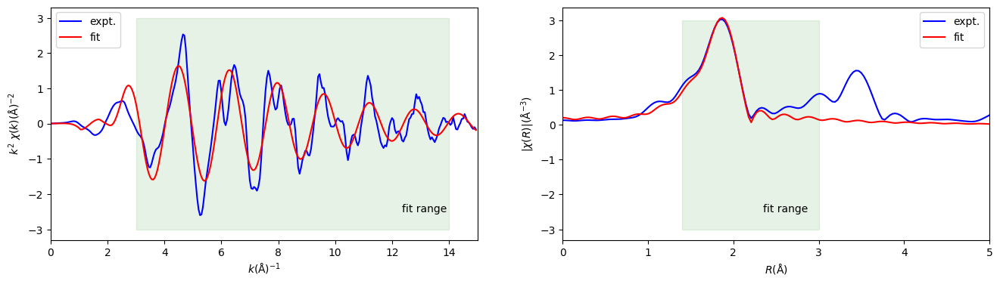

=================== FEFFIT RESULTS ====================
[[Statistics]]
   nvarys, npts       =  4, 104
   n_independent      =  12.205
   chi_square         =  7017.82147
   reduced chi_square =  855.361647
   r-factor           =  0.05548661
   Akaike info crit   =  85.5523589
   Bayesian info crit =  87.5595804
 
[[Data]]
   fit space          = 'r'
   r-range            = 1.400, 3.000
   k-range            = 3.000, 14.000
   k window, dk       = 'hanning', 1.000
   paths used in fit  = ['FeS2_feff/feff0001.dat']
   k-weight           = 2
   epsilon_k          = Array(mean=5.01912e-4, std=4.60149e-4)
   epsilon_r          = 0.01038113
   n_independent      = 12.205
 
[[Variables]]
   amp            =  0.70005799 +/- 0.10855822   (init=  1.00000000)
   delr           =  0.00628887 +/- 0.01131756   (init=  0.00000000)
   enot           =  4.28918767 +/- 1.84570108   (init=  0.00000000)
   ss             =  0.00289900 +/- 0.00131587   (init=  0.00000000)
 
[[Correlations]]    (unreporte

In [19]:
# run fit
trans, dset, out = fit_manager.run_fit(athena_groups[0], gds, fit_paths, fit_vars, session)

# plot fit and spectra
#rmr_p = fit_manager.plot_rmr(dset,fit_vars['rmin'],fit_vars['rmax'])
#rmr_p.show()

chikr_p = fit_manager.plot_chikr(dset,fit_vars['rmin'],fit_vars['rmax'],fit_vars['kmin'],fit_vars['kmax'])
chikr_p.show()
# show fit report
fit_report = fit_manager.get_fit_report(out, session)
print(fit_report)

### 14. Extend fit range & Select 4 paths
Extend the fit range to cover the split peak between 2.3 and 3.9 Angstroms. 

#### 14a Extend fit range
For this there is a relationship between r and k:

R = 2$\pi$/k

In this case extending the range means to encompass up to 3.9

Rmax = 3.9,  kmax = 2$\pi$/Rmax = 2$\pi$/3.9 =  1.61107

only kmin and rmax need to be changed

In [20]:
# change variables for fit
fit_vars['kmin']=1.61107 
fit_vars['rmax']=3.9

#### 14b. Extend fit range & Select 4 paths
Include each of the first four paths in the fit.

In [21]:
sp_file = "fes2_sp_14.csv"
sp_list_csv = Path(data_location, sp_file)

# a list is declared to hold the selected paths
selected_paths =[]
if (sp_list_csv.exists()):
    # read saved parameters from input gds file
    selected_paths = fit_manager.read_selected_paths_list(sp_list_csv, session)
# show the selected paths and allow assigninh GDS variables
# in this case only sigma2 varies
sp_sheet = fit_manager.show_selected_paths(path_sheet, selected_paths)
display(sp_sheet)

Sheet(cells=(Cell(column_end=5, column_start=0, row_end=11, row_start=0, squeeze_column=False, squeeze_row=Fal…

In [22]:
# read the paths from the path sheet
selected_paths = fit_manager.build_selected_paths_list(sp_sheet, session)
# save the selected paths to the csv file
sel_paths_csv = Path(data_location,"fes2_sp_14.csv")
fit_manager.save_selected_paths_list(sp_sheet, sel_paths_csv)

### 15 Define new parameter for the paths
Now you need to set parameters for the paths you just included. It is reasonable to use the same S02 and E0 parameters for each path. Should **Delta R** be the same for each path? Should **sigma^2**? Come up with some reasonable parametrization, either by making interesting constraints between the paths or by creating new guess parameters as needed.

we defined independent variables for sigma^2 and Delta R (ss1,ss2,ss3, delr1,delr2, delr3)

In [23]:
gds_file = "fes2_gds_15.csv"
fit_gds_variables_csv = Path(data_location, gds_file)

if (fit_gds_variables_csv.exists()):
    # read saved parameters from input gds file
    gds = fit_manager.read_gds(fit_gds_variables_csv, session)
this_sheet = fit_manager.show_gds(gds)

Sheet(cells=(Cell(column_start=0, row_end=20, row_start=0, squeeze_column=False, squeeze_row=False, value=[['i…

In [24]:
gds = fit_manager.spreadsheet_to_gds(this_sheet, session)
# save gsd group parameters in a csv file
fit_gds_variables_csv = Path(data_location,"fes2_gds_15.csv")
fit_manager.save_gds(gds, fit_gds_variables_csv)

### 16. Run fit with four paths
Make a fit using your parametrization. 

Are the best fit values reasonable? 
How might you change the parametrization? 
Is it possible to make constraints between the paths?

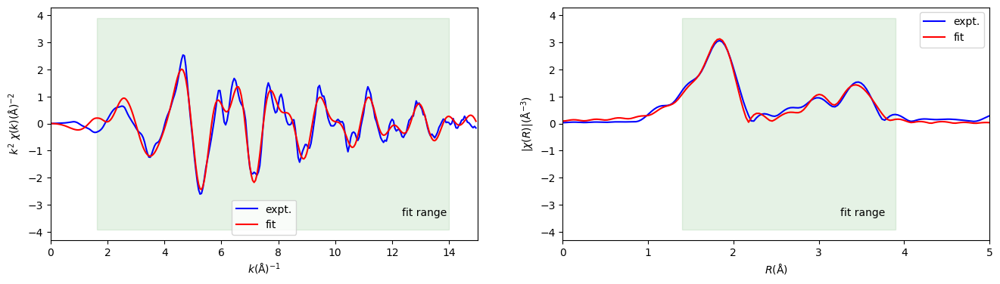

=================== FEFFIT RESULTS ====================
[[Statistics]]
   nvarys, npts       =  10, 164
   n_independent      =  20.718
   chi_square         =  2998.16710
   reduced chi_square =  279.742540
   r-factor           =  0.01714645
   Akaike info crit   =  123.065332
   Bayesian info crit =  133.375165
 
[[Data]]
   fit space          = 'r'
   r-range            = 1.400, 3.900
   k-range            = 1.611, 14.000
   k window, dk       = 'hanning', 1.000
   paths used in fit  = ['FeS2_feff/feff0001.dat', 'FeS2_feff/feff0002.dat', 'FeS2_feff/feff0003.dat', 'FeS2_feff/feff0004.dat']
   k-weight           = 2
   epsilon_k          = Array(mean=5.01858e-4, std=4.60160e-4)
   epsilon_r          = 0.01038225
   n_independent      = 20.718
 
[[Variables]]
   amp            =  0.70726519 +/- 0.05817420   (init=  1.00000000)
   delr           = -0.00545529 +/- 0.00592489   (init=  0.00000000)
   delr1          =  0.01929811 +/- 0.01768746   (init=  0.00000000)
   delr2          =  0

In [25]:
fit_paths = []
for i in range(4):
    fit_paths.append(selected_paths[i])
    
# run fit
trans, dset, out = fit_manager.run_fit(athena_groups[0], gds, fit_paths, fit_vars, session)

# plot fit and spectra
#rmr_p = fit_manager.plot_rmr(dset,fit_vars['rmin'],fit_vars['rmax'])
#rmr_p.show()

chikr_p = fit_manager.plot_chikr(dset,fit_vars['rmin'],fit_vars['rmax'],fit_vars['kmin'],fit_vars['kmax'])
chikr_p.show()
# show fit report
fit_report = fit_manager.get_fit_report(out, session)
print(fit_report)

### 17. Correlation of delta r
FeS2 is a cubic material (it’s space group is Pa3 – a cubic group). This means we can use the trick of modeling the delta R parameters by an isotropic expansion coefficient. Discard whatever Delta R parameters you might have. 

Define Delta R for each path to be “alpha\*reff”. Remember that “reff” always evaluates to the nominal path length as used in Feff when a path parameter math expression is interpreted. 
Make alpha a guess parameter.

In [26]:
gds_file = "fes2_gds_17.csv"
fit_gds_variables_csv = Path(data_location, gds_file)

if (fit_gds_variables_csv.exists()):
    # read saved parameters from input gds file
    gds = fit_manager.read_gds(fit_gds_variables_csv, session)
this_sheet = fit_manager.show_gds(gds)


Sheet(cells=(Cell(column_start=0, row_end=17, row_start=0, squeeze_column=False, squeeze_row=False, value=[['i…

In [27]:
# copy the parameters in the gds group
gds = fit_manager.spreadsheet_to_gds(this_sheet, session)
# save gsd group parameters in a csv file
fit_gds_variables_csv = Path(data_location,"fes2_gds_17.csv")
fit_manager.save_gds(gds, fit_gds_variables_csv)


In [28]:
sp_file = "fes2_sp_17.csv"
sp_list_csv = Path(data_location, sp_file)

# a list is declared to hold the selected paths
selected_paths =[]
if (sp_list_csv.exists()):
    # read saved parameters from input gds file
    selected_paths = fit_manager.read_selected_paths_list(sp_list_csv, session)
# show the selected paths and allow assigninh GDS variables
# in this case sigma2 varies and deltar is now alpha*reff
sp_sheet = fit_manager.show_selected_paths(path_sheet, selected_paths)
display(sp_sheet)

Sheet(cells=(Cell(column_end=5, column_start=0, row_end=11, row_start=0, squeeze_column=False, squeeze_row=Fal…

In [29]:
# read the paths from the path sheet
selected_paths = fit_manager.build_selected_paths_list(sp_sheet, session)

# save the selected paths to the csv file
sel_paths_csv = Path(data_location,"fes2_sp_17.csv")
fit_manager.save_selected_paths_list(sp_sheet, sel_paths_csv)

fit_paths = []
for i in range(4):
    fit_paths.append(selected_paths[i])

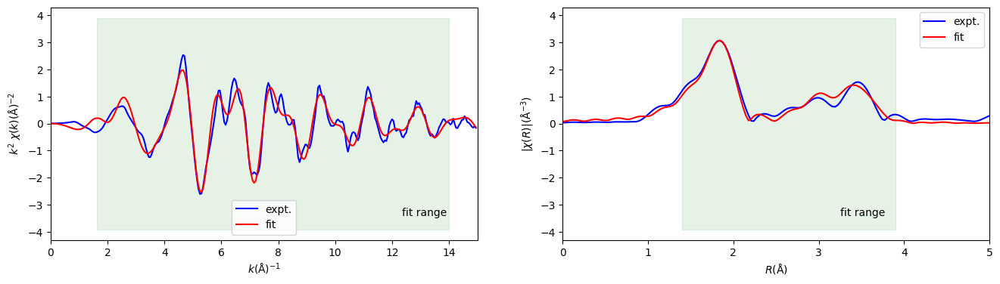

=================== FEFFIT RESULTS ====================
[[Statistics]]
   nvarys, npts       =  7, 164
   n_independent      =  20.718
   chi_square         =  4712.74595
   reduced chi_square =  343.554838
   r-factor           =  0.02695209
   Akaike info crit   =  126.435270
   Bayesian info crit =  133.652153
 
[[Data]]
   fit space          = 'r'
   r-range            = 1.400, 3.900
   k-range            = 1.611, 14.000
   k window, dk       = 'hanning', 1.000
   paths used in fit  = ['FeS2_feff/feff0001.dat', 'FeS2_feff/feff0002.dat', 'FeS2_feff/feff0003.dat', 'FeS2_feff/feff0004.dat']
   k-weight           = 2
   epsilon_k          = Array(mean=5.01858e-4, std=4.60160e-4)
   epsilon_r          = 0.01038225
   n_independent      = 20.718
 
[[Variables]]
   alpha          = -0.00157273 +/- 0.00236686   (init=  0.00000000)
   amp            =  0.65851436 +/- 0.05495374   (init=  1.00000000)
   enot           =  1.44585687 +/- 0.95199671   (init=  0.00000000)
   ss             =  0.

In [30]:
# run fit
trans, dset, out = fit_manager.run_fit(athena_groups[0], gds, fit_paths, fit_vars, session)

# plot fit and spectra
#rmr_p = fit_manager.plot_rmr(dset,fit_vars['rmin'],fit_vars['rmax'])
#rmr_p.show()

chikr_p = fit_manager.plot_chikr(dset,fit_vars['rmin'],fit_vars['rmax'],fit_vars['kmin'],fit_vars['kmax'])
chikr_p.show()
# show fit report
fit_report = fit_manager.get_fit_report(out, session)
print(fit_report)

### 18. Try adding other paths
What other paths contribute significant spectral weight in the region between 2.3 and 3.7 Angstroms? Consider including important MS paths and the fourth shell S atom to the fit. How about paths 13 and 14, which are collinear paths involving the absorber and 1st shell S atoms?

**Answer:**

In this case paths 5 and 6 might also contribute (looking at the solution to 9). 7 and 8 are too low. 9 peaks outside the range  the rest are too small or outside the range. 10 and 11 are again too low

In [31]:
gds_file = "fes2_gds_18.csv"
fit_gds_variables_csv = Path(data_location, gds_file)

if (fit_gds_variables_csv.exists()):
    # read saved parameters from input gds file
    gds = fit_manager.read_gds(fit_gds_variables_csv, session)
# update the parameters
this_sheet = fit_manager.show_gds(gds)

Sheet(cells=(Cell(column_start=0, row_end=19, row_start=0, squeeze_column=False, squeeze_row=False, value=[['i…

In [32]:
# copy the parameters in the gds group
gds = fit_manager.spreadsheet_to_gds(this_sheet, session)
# save gsd group parameters in a csv file
fit_gds_variables_csv = Path(data_location,"fes2_gds_18.csv")
fit_manager.save_gds(gds, fit_gds_variables_csv)


In [33]:
sp_file = "fes2_sp_18.csv"
sp_list_csv = Path(data_location, sp_file)

# a list is declared to hold the selected paths
selected_paths =[]
if (sp_list_csv.exists()):
    # read saved parameters from input gds file
    selected_paths = fit_manager.read_selected_paths_list(sp_list_csv, session)

# show the selected paths and allow assigning GDS variables
sp_sheet = fit_manager.show_selected_paths(path_sheet, selected_paths)
display(sp_sheet)

Sheet(cells=(Cell(column_end=5, column_start=0, row_end=11, row_start=0, squeeze_column=False, squeeze_row=Fal…

In [34]:
# read the paths from the path sheet
selected_paths = fit_manager.build_selected_paths_list(sp_sheet, session)
# save the selected paths to the csv file
sel_paths_csv = Path(data_location,"fes2_sp_18.csv")
fit_manager.save_selected_paths_list(sp_sheet, sel_paths_csv)

# set use to true for paths 5 - 6
fit_paths = []
for i in range(6):
    fit_paths.append(selected_paths[i])


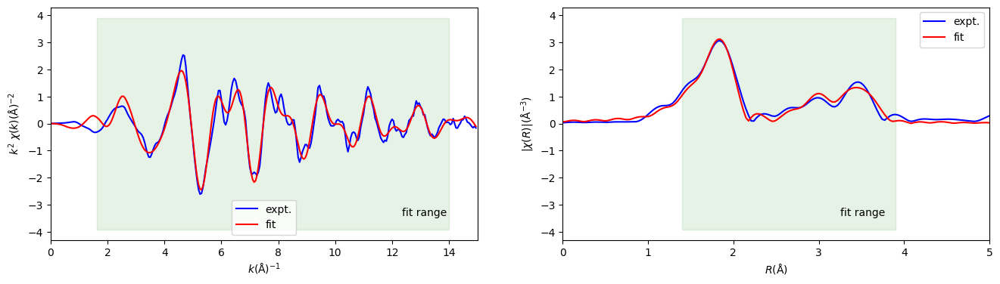

=================== FEFFIT RESULTS ====================
[[Statistics]]
   nvarys, npts       =  9, 164
   n_independent      =  20.718
   chi_square         =  4457.31191
   reduced chi_square =  380.394791
   r-factor           =  0.02549127
   Akaike info crit   =  129.280785
   Bayesian info crit =  138.559635
 
[[Data]]
   fit space          = 'r'
   r-range            = 1.400, 3.900
   k-range            = 1.611, 14.000
   k window, dk       = 'hanning', 1.000
   paths used in fit  = ['FeS2_feff/feff0001.dat', 'FeS2_feff/feff0002.dat', 'FeS2_feff/feff0003.dat', 'FeS2_feff/feff0004.dat', 'FeS2_feff/feff0005.dat', 'FeS2_feff/feff0006.dat']
   k-weight           = 2
   epsilon_k          = Array(mean=5.01858e-4, std=4.60160e-4)
   epsilon_r          = 0.01038225
   n_independent      = 20.718
 
[[Variables]]
   alpha          = -0.00212841 +/- 0.00233848   (init=  0.00000000)
   amp            =  0.67880139 +/- 0.06306100   (init=  1.00000000)
   enot           =  1.22347049 +/- 0.96

In [35]:
# run fit
trans, dset, out = fit_manager.run_fit(athena_groups[0], gds, fit_paths, fit_vars, session)

# plot fit and spectra
#rmr_p = fit_manager.plot_rmr(dset,fit_vars['rmin'],fit_vars['rmax'])
#rmr_p.show()

chikr_p = fit_manager.plot_chikr(dset,fit_vars['rmin'],fit_vars['rmax'],fit_vars['kmin'],fit_vars['kmax'])
chikr_p.show()
# show fit report
fit_report = fit_manager.get_fit_report(out, session)
print(fit_report)

### 19. Multiple scattering paths

Can you think of a way to approximate the sigma^2 for the MS paths using math expressions, def parameters, and the sigma^2 parameters that are used to fit the SS paths?

**Answer:**

Having a path that is single scattering, with a σ2 = ss1, The next multiscattering paths can be defined in terms of SS1 as follows(see [Demeter guide](https://bruceravel.github.io/demeter/documents/Artemis/extended/ss.html)):
- Collinear double scattering (DS) and triple scattering (TS) paths can be approximated using σ2 = 2*ss1. 
- The path in which the photoelectron rattles back and forth between the absorber and atom 1 has σ2 = 4*ss1.



In [36]:
sp_file = "fes2_sp_19.csv"
sp_list_csv = Path(data_location, sp_file)

# a list is declared to hold the selected paths
selected_paths =[]
if (sp_list_csv.exists()):
    # read saved parameters from input gds file
    selected_paths = fit_manager.read_selected_paths_list(sp_list_csv, session)

# show the selected paths and allow assigning GDS variables
sp_sheet = fit_manager.show_selected_paths(path_sheet, selected_paths)
display(sp_sheet)

Sheet(cells=(Cell(column_end=5, column_start=0, row_end=11, row_start=0, squeeze_column=False, squeeze_row=Fal…

In [37]:
# read the paths from the path sheet
selected_paths = fit_manager.build_selected_paths_list(sp_sheet, session)
# save the selected paths to the csv file
sel_paths_csv = Path(data_location,"fes2_sp_19.csv")
fit_manager.save_selected_paths_list(sp_sheet, sel_paths_csv)

# use paths 1 - 6
fit_paths = []
for i in range(6):
    fit_paths.append(selected_paths[i])

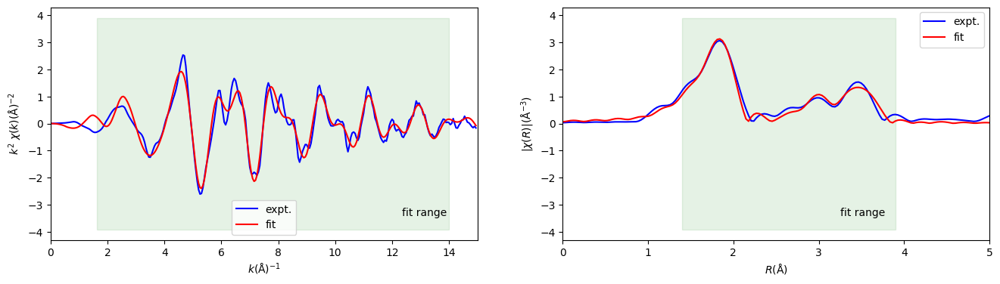

=================== FEFFIT RESULTS ====================
[[Statistics]]
   nvarys, npts       =  9, 164
   n_independent      =  20.718
   chi_square         =  5001.92581
   reduced chi_square =  426.873094
   r-factor           =  0.02860591
   Akaike info crit   =  131.669050
   Bayesian info crit =  140.947899
 
[[Data]]
   fit space          = 'r'
   r-range            = 1.400, 3.900
   k-range            = 1.611, 14.000
   k window, dk       = 'hanning', 1.000
   paths used in fit  = ['FeS2_feff/feff0001.dat', 'FeS2_feff/feff0002.dat', 'FeS2_feff/feff0003.dat', 'FeS2_feff/feff0004.dat', 'FeS2_feff/feff0005.dat', 'FeS2_feff/feff0006.dat']
   k-weight           = 2
   epsilon_k          = Array(mean=5.01858e-4, std=4.60160e-4)
   epsilon_r          = 0.01038225
   n_independent      = 20.718
 
[[Variables]]
   alpha          = -0.00180409 +/-unknown   (init=  0.00000000)
   amp            =  0.70656783 +/-unknown   (init=  1.00000000)
   enot           =  1.22645881 +/-unknown   (in

In [38]:
# run fit
trans, dset, out = fit_manager.run_fit(athena_groups[0], gds, fit_paths, fit_vars, session)

# plot fit and spectra
#rmr_p = fit_manager.plot_rmr(dset,fit_vars['rmin'],fit_vars['rmax'])
#rmr_p.show()

chikr_p = fit_manager.plot_chikr(dset,fit_vars['rmin'],fit_vars['rmax'],fit_vars['kmin'],fit_vars['kmax'])
chikr_p.show()
# show fit report
fit_report = fit_manager.get_fit_report(out, session)
print(fit_report)

### 20. Further modelling
The 2nd and 3rd shells are both S and are relatively close together in length. Test to see if the data support measuring sigma^2 independently for those two paths by comparing a fit in which they are constrained to be to same to a fit in which the float freely.

**Answer**

The solution to 18 was provided with independent σ2 for pats 5 and 6 (ss4, ss5), in 19 they vary according to theory and are both set to ss\*2 (ss is the σ2 for path 1). The R factor is smaller for the independently varying σ2s. So it appears that independent variation works better. 

### 21. S  coordinate 
If you look at the atoms information, you will see that this structure is actually defined by two parameters – the lattice constant and the position of the S atom. The variation in the lattice constant is accommodated in our fit using the isotropic expansion constant alpha. How might you include the possibility of refining the S coordinate in the fit?
